In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import rcParams
import plotly.express as px


In [2]:
c_green = '#6DF10C'
c_yellow = '#F5DD0D'
c_cyan = '#0FFDEF'
c_blue = '#0141DE'
c_blue_light =  '#2775FD'
c_purple = '#FF0DE5'
c_green_dark = '#1BB200'
e = np.e


sns.set_style('darkgrid')
plt.rcParams['font.size'] = 14
plt.rcParams['figure.figsize'] = (10, 6)
plt.rcParams['figure.facecolor'] = '#00000000'

## About Dataset

Link To Dataset : https://www.kaggle.com/datasets/hiteshsoneji/historical-weather-data-for-indian-cities/data?select=bombay.csv

Context
The dataset was created by keeping in mind the necessity of such historical weather data in the community. The datasets for top 8 Indian cities as per the population.

Content
The dataset was used with the help of the worldweatheronline.com API and the wwo_hist package. The datasets contain hourly weather data from 01-01-2009 to 01-01-2020. The data of each city is for more than 10 years. This data can be used to visualize the change in data due to global warming or can be used to predict the weather for upcoming days, weeks, months, seasons, etc.
Note : The data was extracted with the help of worldweatheronline.com API and I can't guarantee about the accuracy of the data.

Acknowledgements
The data is owned by worldweatheronline.com and is extracted with the help of their API.

Inspiration
The main target of this dataset can be used to predict weather for the next day or week with huge amounts of data provided in the dataset. Furthermore, this data can also be used to make visualization which would help to understand the impact of global warming over the various aspects of the weather like precipitation, humidity, temperature, etc.

In [3]:
df = pd.read_csv('csv\\bombay.csv', encoding='latin-1')
df

,date_time,maxtempC,mintempC,uvIndex,DewPointC,FeelsLikeC,HeatIndexC,WindChillC,WindGustKmph,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph
0,01-01-2009 00:00,30,22,1,15,28,28,27,11,0,49,0.0,1012,22,10,20,10
1,01-01-2009 01:00,30,22,1,15,27,27,26,12,0,50,0.0,1012,22,10,18,11
2,01-01-2009 02:00,30,22,1,15,27,27,26,14,0,50,0.0,1012,22,10,16,12
3,01-01-2009 03:00,30,22,1,14,25,26,25,15,0,50,0.0,1012,22,10,14,13
4,01-01-2009 04:00,30,22,1,14,26,26,26,14,0,49,0.0,1013,22,10,28,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96427,01-01-2020 19:00,27,24,6,18,26,26,25,16,4,64,0.0,1014,25,10,324,14
96428,01-01-2020 20:00,27,24,1,18,26,26,25,15,4,65,0.0,1015,25,10,330,13
96429,01-01-2020 21:00,27,24,1,18,26,26,25,14,4,67,0.0,1015,25,10,335,13
96430,01-01-2020 22:00,27,24,1,18,26,26,25,13,4,66,0.0,1015,25,10,301,12


In [4]:
df.isnull().sum()

date_time        0
maxtempC         0
mintempC         0
uvIndex          0
DewPointC        0
FeelsLikeC       0
HeatIndexC       0
WindChillC       0
WindGustKmph     0
cloudcover       0
humidity         0
precipMM         0
pressure         0
tempC            0
visibility       0
winddirDegree    0
windspeedKmph    0
dtype: int64

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 96432 entries, 0 to 96431
Data columns (total 17 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   date_time      96432 non-null  object 
 1   maxtempC       96432 non-null  int64  
 2   mintempC       96432 non-null  int64  
 3   uvIndex        96432 non-null  int64  
 4   DewPointC      96432 non-null  int64  
 5   FeelsLikeC     96432 non-null  int64  
 6   HeatIndexC     96432 non-null  int64  
 7   WindChillC     96432 non-null  int64  
 8   WindGustKmph   96432 non-null  int64  
 9   cloudcover     96432 non-null  int64  
 10  humidity       96432 non-null  int64  
 11  precipMM       96432 non-null  float64
 12  pressure       96432 non-null  int64  
 13  tempC          96432 non-null  int64  
 14  visibility     96432 non-null  int64  
 15  winddirDegree  96432 non-null  int64  
 16  windspeedKmph  96432 non-null  int64  
dtypes: float64(1), int64(15), object(1)
memory usage: 

In [6]:
df.describe()

,maxtempC,mintempC,uvIndex,DewPointC,FeelsLikeC,HeatIndexC,WindChillC,WindGustKmph,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph
count,96432.000000,96432.000000,96432.000000,96432.000000,96432.000000,96432.000000,96432.000000,96432.000000,96432.000000,96432.000000,96432.000000,96432.000000,96432.000000,96432.000000,96432.000000,96432.000000
mean,30.761075,24.917870,4.289831,21.774618,32.819541,32.873776,29.097810,16.417144,24.856593,66.708914,0.152278,1009.399567,27.528414,9.748247,213.206882,11.799973
std,2.196361,2.471196,3.077436,3.854042,4.554669,4.465167,2.879104,10.169945,28.987203,15.997022,0.586189,3.750589,2.889144,1.077000,98.703720,6.034329
min,24.000000,17.000000,1.000000,1.000000,17.000000,18.000000,17.000000,0.000000,0.000000,20.000000,0.000000,996.000000,0.000000,2.000000,0.000000,0.000000
25%,29.000000,23.000000,1.000000,19.000000,30.000000,30.000000,27.000000,10.000000,1.000000,54.000000,0.000000,1007.000000,26.000000,10.000000,147.000000,8.000000
50%,31.000000,25.000000,6.000000,23.000000,32.000000,32.000000,29.000000,14.000000,9.000000,68.000000,0.000000,1010.000000,27.000000,10.000000,240.000000,11.000000
75%,32.000000,27.000000,7.000000,25.000000,35.000000,35.000000,31.000000,20.000000,47.000000,81.000000,0.000000,1012.000000,29.000000,10.000000,288.000000,15.000000
max,38.000000,31.000000,9.000000,31.000000,58.000000,58.000000,43.000000,85.000000,100.000000,96.000000,22.500000,1020.000000,38.000000,20.000000,360.000000,47.000000


In [7]:
num_cols = df.select_dtypes(include=np.number).columns.to_list()
cat_cols = df.select_dtypes(include='object').columns.to_list()
corr_cols_temp = ['maxtempC', 'mintempC','uvIndex','HeatIndexC','FeelsLikeC','WindChillC','winddirDegree','windspeedKmph','WindGustKmph','tempC']
input_cols_temp = ['maxtempC', 'mintempC','uvIndex','HeatIndexC','FeelsLikeC','WindChillC','winddirDegree','windspeedKmph','WindGustKmph']
target_col_temp = 'tempC'




## Here's how correlation coefficients can be interpreted ([source](https://statisticsbyjim.com/basics/correlations)):

* **Strength**: The greater the absolute value of the correlation coefficient, the stronger the relationship.

    * The extreme values of -1 and 1 indicate a perfectly linear relationship where a change in one variable is accompanied by a perfectly consistent change in the other. For these relationships, all of the data points fall on a line. In practice, you won’t see either type of perfect relationship.

    * A coefficient of zero represents no linear relationship. As one variable increases, there is no tendency in the other variable to either increase or decrease.
    
    * When the value is in-between 0 and +1/-1, there is a relationship, but the points don’t all fall on a line. As r approaches -1 or 1, the strength of the relationship increases and the data points tend to fall closer to a line.


* **Direction**: The sign of the correlation coefficient represents the direction of the relationship.

    * Positive coefficients indicate that when the value of one variable increases, the value of the other variable also tends to increase. Positive relationships produce an upward slope on a scatterplot.
    
    * Negative coefficients represent cases when the value of one variable increases, the value of the other variable tends to decrease. Negative relationships produce a downward slope.

Here's the same relationship expressed visually ([source](https://www.cuemath.com/data/how-to-calculate-correlation-coefficient/)):

<img src="https://i.imgur.com/3XUpDlw.png" width="360">

The correlation coefficient has the following formula:

<img src="https://i.imgur.com/unapugP.png" width="360">



Pandas dataframes also provide a `.corr` method to compute the correlation coefficients between all pairs of numeric columns.

In [8]:
df_corr = df[num_cols].corr()
df_corr

,maxtempC,mintempC,uvIndex,DewPointC,FeelsLikeC,HeatIndexC,WindChillC,WindGustKmph,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph
maxtempC,1.000000,0.247118,0.091730,-0.005087,0.505552,0.505137,0.595849,-0.327946,-0.501154,-0.413268,-0.266683,0.210381,0.449037,0.268974,-0.043651,-0.298024
mintempC,0.247118,1.000000,0.016604,0.713907,0.537098,0.523838,0.265694,0.222627,0.414097,0.472669,0.117575,-0.548602,0.528840,-0.119840,0.183474,0.209383
uvIndex,0.091730,0.016604,1.000000,0.005325,0.434804,0.431355,0.559253,0.134962,-0.161506,-0.337594,-0.050153,-0.009591,0.618751,0.041974,0.390195,0.234174
DewPointC,-0.005087,0.713907,0.005325,1.000000,0.569519,0.566113,0.178691,0.125684,0.481772,0.780522,0.185413,-0.666915,0.357375,-0.203141,0.296480,0.092295
FeelsLikeC,0.505552,0.537098,0.434804,0.569519,1.000000,0.997569,0.871827,-0.115369,-0.110759,-0.033418,-0.062585,-0.253250,0.814710,0.049995,0.289099,-0.050601
HeatIndexC,0.505137,0.523838,0.431355,0.566113,0.997569,1.000000,0.869448,-0.123509,-0.121282,-0.036047,-0.066478,-0.248239,0.801410,0.053105,0.283009,-0.057619
WindChillC,0.595849,0.265694,0.559253,0.178691,0.871827,0.869448,1.000000,-0.182010,-0.349260,-0.448108,-0.153449,0.029945,0.838724,0.144735,0.232775,-0.093747
WindGustKmph,-0.327946,0.222627,0.134962,0.125684,-0.115369,-0.123509,-0.182010,1.000000,0.469266,0.248014,0.480521,-0.498019,0.100944,-0.397421,0.238593,0.955491
cloudcover,-0.501154,0.414097,-0.161506,0.481772,-0.110759,-0.121282,-0.349260,0.469266,1.000000,0.701742,0.399740,-0.656733,-0.021004,-0.395862,0.104648,0.377784
humidity,-0.413268,0.472669,-0.337594,0.780522,-0.033418,-0.036047,-0.448108,0.248014,0.701742,1.000000,0.287088,-0.652441,-0.190452,-0.304068,0.128721,0.155199


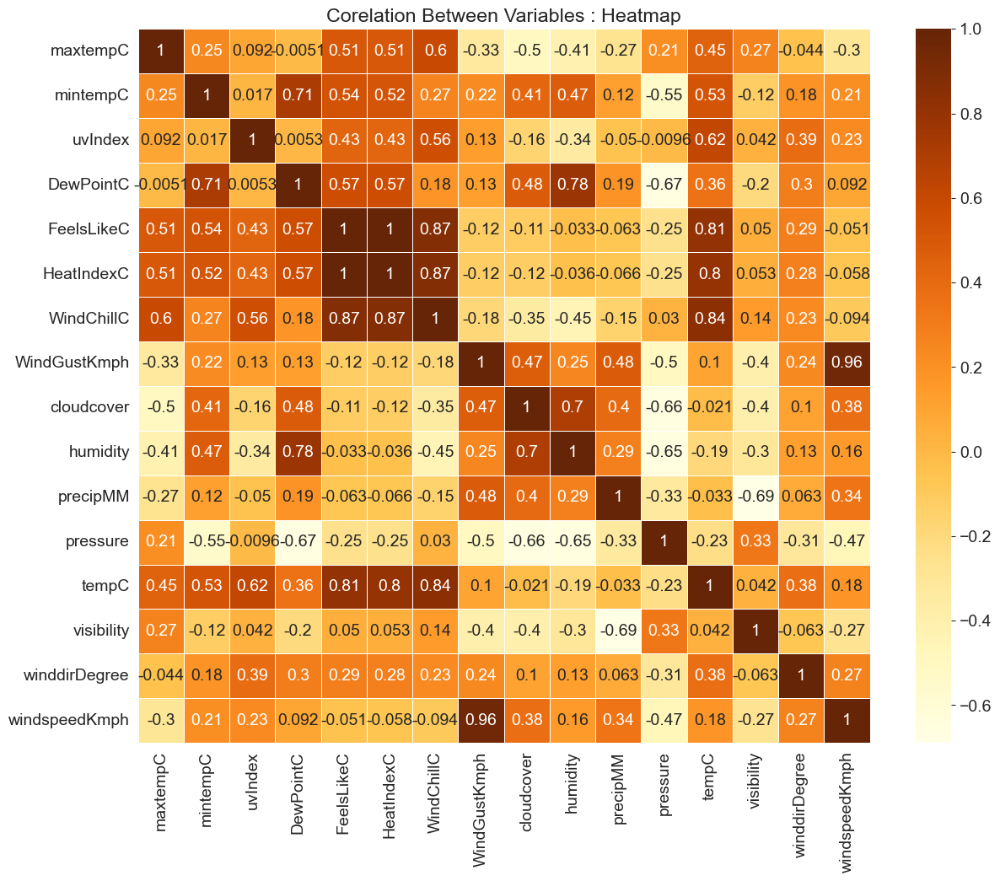

In [9]:
plt.rcParams['figure.figsize'] = (14,11)
sns.heatmap(df_corr , annot=True ,cmap="YlOrBr" , linewidth=0.5)
plt.title('Corelation Between Variables : Heatmap')
plt.show()

In [10]:
df_corr_temp = df[corr_cols_temp].corr()
df_corr_temp

,maxtempC,mintempC,uvIndex,HeatIndexC,FeelsLikeC,WindChillC,winddirDegree,windspeedKmph,WindGustKmph,tempC
maxtempC,1.000000,0.247118,0.091730,0.505137,0.505552,0.595849,-0.043651,-0.298024,-0.327946,0.449037
mintempC,0.247118,1.000000,0.016604,0.523838,0.537098,0.265694,0.183474,0.209383,0.222627,0.528840
uvIndex,0.091730,0.016604,1.000000,0.431355,0.434804,0.559253,0.390195,0.234174,0.134962,0.618751
HeatIndexC,0.505137,0.523838,0.431355,1.000000,0.997569,0.869448,0.283009,-0.057619,-0.123509,0.801410
FeelsLikeC,0.505552,0.537098,0.434804,0.997569,1.000000,0.871827,0.289099,-0.050601,-0.115369,0.814710
WindChillC,0.595849,0.265694,0.559253,0.869448,0.871827,1.000000,0.232775,-0.093747,-0.182010,0.838724
winddirDegree,-0.043651,0.183474,0.390195,0.283009,0.289099,0.232775,1.000000,0.273170,0.238593,0.375009
windspeedKmph,-0.298024,0.209383,0.234174,-0.057619,-0.050601,-0.093747,0.273170,1.000000,0.955491,0.179351
WindGustKmph,-0.327946,0.222627,0.134962,-0.123509,-0.115369,-0.182010,0.238593,0.955491,1.000000,0.100944
tempC,0.449037,0.528840,0.618751,0.801410,0.814710,0.838724,0.375009,0.179351,0.100944,1.000000


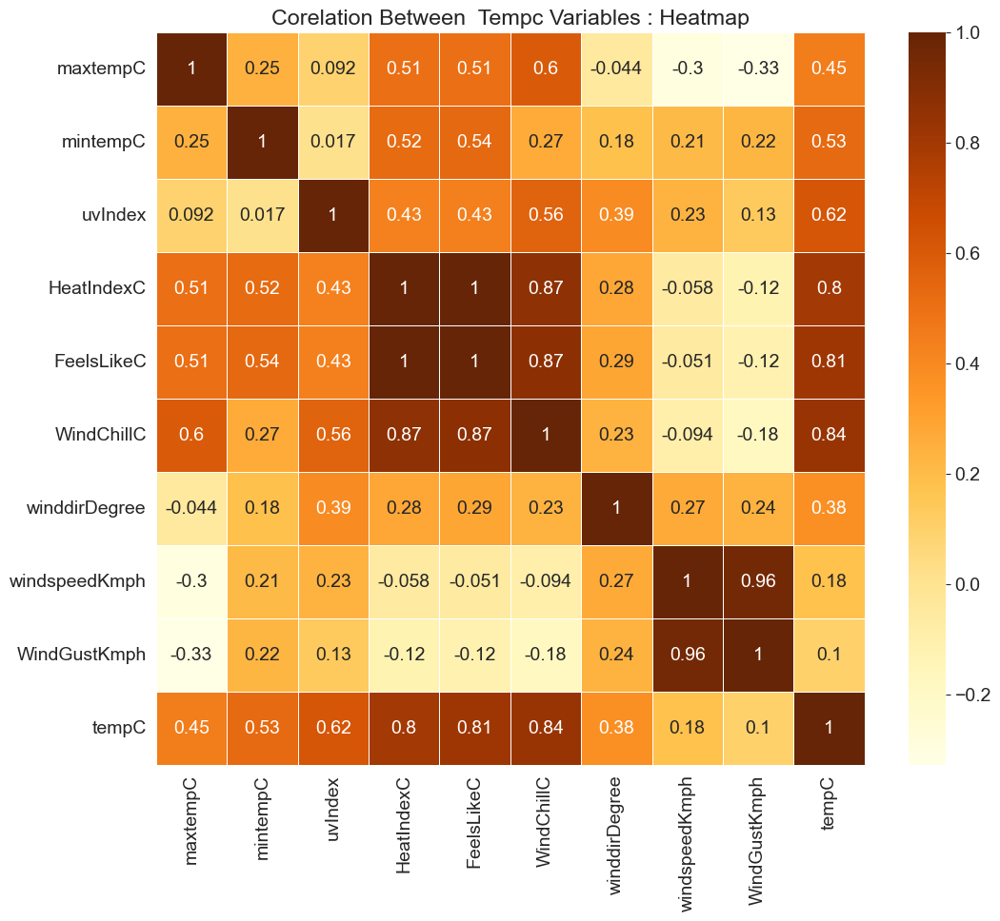

In [11]:
plt.rcParams['figure.figsize'] = (12,10)
sns.heatmap(df_corr_temp , annot=True ,cmap="YlOrBr" , linewidth=.5)
plt.title('Corelation Between  Tempc Variables : Heatmap')
plt.show()

In [12]:
df[corr_cols_temp].describe()

,maxtempC,mintempC,uvIndex,HeatIndexC,FeelsLikeC,WindChillC,winddirDegree,windspeedKmph,WindGustKmph,tempC
count,96432.000000,96432.000000,96432.000000,96432.000000,96432.000000,96432.000000,96432.000000,96432.000000,96432.000000,96432.000000
mean,30.761075,24.917870,4.289831,32.873776,32.819541,29.097810,213.206882,11.799973,16.417144,27.528414
std,2.196361,2.471196,3.077436,4.465167,4.554669,2.879104,98.703720,6.034329,10.169945,2.889144
min,24.000000,17.000000,1.000000,18.000000,17.000000,17.000000,0.000000,0.000000,0.000000,0.000000
25%,29.000000,23.000000,1.000000,30.000000,30.000000,27.000000,147.000000,8.000000,10.000000,26.000000
50%,31.000000,25.000000,6.000000,32.000000,32.000000,29.000000,240.000000,11.000000,14.000000,27.000000
75%,32.000000,27.000000,7.000000,35.000000,35.000000,31.000000,288.000000,15.000000,20.000000,29.000000
max,38.000000,31.000000,9.000000,58.000000,58.000000,43.000000,360.000000,47.000000,85.000000,38.000000


In [13]:
year = pd.to_datetime(df.date_time , format='mixed').dt.year
train_df = df[year < 2019]
test_df = df[year > 2018]

In [14]:
print('train_df.shape :', train_df.shape)
print('test_df.shape :', test_df.shape)

train_df.shape : (87648, 17)
test_df.shape : (8784, 17)


In [15]:
train_df

,date_time,maxtempC,mintempC,uvIndex,DewPointC,FeelsLikeC,HeatIndexC,WindChillC,WindGustKmph,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph
0,01-01-2009 00:00,30,22,1,15,28,28,27,11,0,49,0.0,1012,22,10,20,10
1,01-01-2009 01:00,30,22,1,15,27,27,26,12,0,50,0.0,1012,22,10,18,11
2,01-01-2009 02:00,30,22,1,15,27,27,26,14,0,50,0.0,1012,22,10,16,12
3,01-01-2009 03:00,30,22,1,14,25,26,25,15,0,50,0.0,1012,22,10,14,13
4,01-01-2009 04:00,30,22,1,14,26,26,26,14,0,49,0.0,1013,22,10,28,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
87643,31-12-2018 19:00,29,22,6,14,27,27,27,13,3,46,0.0,1018,24,10,234,11
87644,31-12-2018 20:00,29,22,1,13,26,26,26,11,4,44,0.0,1018,24,10,132,8
87645,31-12-2018 21:00,29,22,1,11,25,25,25,9,6,42,0.0,1018,23,10,31,6
87646,31-12-2018 22:00,29,22,1,12,26,26,26,10,4,42,0.0,1018,25,10,29,8


In [16]:
test_df

,date_time,maxtempC,mintempC,uvIndex,DewPointC,FeelsLikeC,HeatIndexC,WindChillC,WindGustKmph,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph
87648,01-01-2019 00:00,32,24,1,14,28,28,28,12,1,42,0.0,1018,28,10,25,11
87649,01-01-2019 01:00,32,24,1,13,28,28,28,12,1,40,0.0,1018,28,10,33,10
87650,01-01-2019 02:00,32,24,1,12,27,27,27,11,1,38,0.0,1017,27,10,40,10
87651,01-01-2019 03:00,32,24,1,11,27,27,27,11,1,36,0.0,1017,27,10,48,9
87652,01-01-2019 04:00,32,24,1,9,26,26,26,11,2,34,0.0,1017,26,10,54,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96427,01-01-2020 19:00,27,24,6,18,26,26,25,16,4,64,0.0,1014,25,10,324,14
96428,01-01-2020 20:00,27,24,1,18,26,26,25,15,4,65,0.0,1015,25,10,330,13
96429,01-01-2020 21:00,27,24,1,18,26,26,25,14,4,67,0.0,1015,25,10,335,13
96430,01-01-2020 22:00,27,24,1,18,26,26,25,13,4,66,0.0,1015,25,10,301,12


## Impact Due To UV-INDEX

UV index and temperature are two distinct weather parameters that provide different information about atmospheric conditions. Let's break down each concept and then discuss their relationship.


<img src = 'https://cdn.who.int/media/images/default-source/imported/radiation/uv-ultraviolet-index.jpg?sfvrsn=8cd288e_5'>

1. **UV Index:**
   - The UV index measures the strength of ultraviolet (UV) radiation from the sun that reaches the Earth's surface.
   - It is a scale that typically ranges from 0 to 11 or more, with higher values indicating a greater risk of harm from unprotected sun exposure.
   - The UV index is divided into categories, each representing a different level of risk for potential harm:
     - 0-2: Low
     - 3-5: Moderate
     - 6-7: High
     - 8-10: Very high
     - 11 and above: Extreme

2. **Temperature:**
   - Temperature is a measure of the warmth or coldness of the air and is often reported in degrees Celsius (°C) or Fahrenheit (°F).
   - It is a key factor in describing the overall weather conditions, influencing things like the level of comfort, precipitation type, and atmospheric pressure.

Now, let's discuss the relationship between UV index and temperature:

- **Impact on Temperature:**
  - UV radiation from the sun contributes to the warming of the Earth's surface. Therefore, on a sunny day with high UV index values, you might experience warmer temperatures.
  - However, it's important to note that UV index and temperature are not directly proportional. Other factors, such as cloud cover, humidity, and geographical location, also play a significant role in determining the actual temperature.

- **Example for Mumbai:**
  - Mumbai, being located on the west coast of India, typically experiences a tropical climate with high temperatures and humidity.
  - In the summer months, Mumbai can have high UV index values due to the abundant sunshine. This can contribute to elevated temperatures during the day.
  - For instance, on a clear and sunny day with a high UV index, the temperature in Mumbai might reach 35°C or higher, making it feel hotter due to the increased solar radiation.

- **Caution:**
  - While high UV index values may contribute to warmer temperatures, they also indicate an increased risk of sunburn and other harmful effects of UV radiation. It's important to take appropriate precautions, such as using sunscreen and wearing protective clothing, especially during peak UV hours.

In summary, the UV index can influence the perceived temperature, especially on sunny days, but it's just one of several factors that contribute to the overall weather conditions in a given location.

## The correlation between UV index and temperature is generally positive, meaning that as one increases, the other tends to increase as well. However, it's crucial to understand that correlation does not imply causation. While there is a relationship between UV index and temperature, other factors can influence both variables independently.

Here are key points regarding the correlation between UV index and temperature:

1. **Solar Radiation and Temperature:**
   - UV index is a measure of solar radiation, particularly the amount of ultraviolet radiation reaching the Earth's surface. This radiation contributes to the heating of the atmosphere.
   - On sunny days with clear skies, higher UV index values are often associated with increased solar radiation, which can lead to higher temperatures.

2. **Influence of Cloud Cover:**
   - Cloud cover can significantly affect the correlation between UV index and temperature. Even on days with a high UV index, if the sky is heavily overcast, the direct sunlight reaching the surface may be reduced, moderating the temperature.

3. **Geographical and Seasonal Variations:**
   - The correlation can vary based on geographic location and season. For instance, in tropical regions, high UV index values are common, and temperatures can be consistently high. In contrast, in temperate regions, the correlation might be less pronounced, especially during seasons with lower sun angles.

4. **Local Factors:**
   - Local factors, such as elevation, proximity to large bodies of water, and urban heat island effects, can influence the correlation. Coastal areas, for example, might experience milder temperature variations despite high UV index values.

5. **Time of Day:**
   - The correlation between UV index and temperature is often strongest during daylight hours when the sun is a significant factor. At night, UV index becomes irrelevant, but temperature can still be influenced by other atmospheric conditions.

6. **Human Perception:**
   - High UV index values can intensify the perception of warmth, making it feel hotter than the actual air temperature. This is due to the increased solar radiation, which can contribute to a more intense and uncomfortable heat.

In summary, while there is a positive correlation between UV index and temperature, it's essential to consider other factors that can influence each parameter independently. Additionally, the specific nature of the correlation can vary based on location, season, and local atmospheric conditions.

In [17]:
histplot_uvindex = px.histogram(train_df,x = 'uvIndex' , marginal = 'box' , nbins = 10 , title = 'Distribution of UV-INDEX' ,width=1100, height=600)
histplot_uvindex.update_layout(bargap = 0.001)
histplot_uvindex.show()


In [18]:
scatterplot_uvindex = px.scatter(train_df,x = 'uvIndex' , y = 'tempC'  ,title = 'Linear Plot Between TempC and UV-INDEX', width=1000, height=800)
scatterplot_uvindex.update_traces(marker_size = 10)
scatterplot_uvindex.show()

## HeatIndex

The heat index, often referred to as the "apparent temperature" or "feels-like" temperature, is a measure that takes into account both air temperature and humidity to estimate how hot it feels to the human body. It provides a more accurate representation of the impact of weather conditions on comfort and health, considering the reduced ability of the body to cool itself when humidity is high. Let's explore the effect of the heat index on temperature, using Mumbai as an example.

1. **Heat Index Calculation:**
   - The heat index is calculated using a formula that incorporates air temperature and relative humidity. The formula accounts for the fact that high humidity reduces the efficiency of the body's natural cooling mechanism, which is sweating.

   <img src = 'https://www.weather.gov/images/safety/heatindexchart-650.jpg'>

2. **Example in Mumbai:**
   - Mumbai, being located on the west coast of India, experiences a tropical climate with high temperatures and high humidity levels, especially during the monsoon season.
   - Let's consider a scenario where the air temperature in Mumbai is 32°C (approximately 89.6°F) with a relative humidity of 80%. Using the heat index formula, the calculated heat index might be higher than the actual temperature due to the impact of humidity.

3. **Perceived Temperature:**
   - The heat index provides a measure of the perceived temperature, which is often higher than the actual air temperature when humidity is significant. In the example above, the heat index could make it feel like the temperature is, for instance, 36°C (approximately 96.8°F), indicating a more uncomfortable and warmer sensation.

4. **Risk of Heat-Related Illnesses:**
   - High heat index values are associated with an increased risk of heat-related illnesses. Prolonged exposure to elevated heat index conditions can lead to heat exhaustion or heatstroke, especially if individuals are engaged in strenuous physical activities without adequate hydration and rest.

5. **Variation Throughout the Day:**
   - The heat index tends to be highest during the hottest part of the day, typically in the afternoon. As the sun sets and temperatures cool, the heat index decreases, providing some relief.

6. **Impact on Outdoor Activities:**
   - The heat index is an essential metric for assessing the suitability of outdoor activities. High heat index values may warrant precautions such as staying hydrated, taking breaks in the shade, and avoiding strenuous activities during peak heat hours.

In summary, the heat index reflects the combined effect of temperature and humidity on the perceived warmth. In a place like Mumbai, with its tropical climate and often high humidity levels, the heat index can significantly impact how individuals experience and respond to the weather conditions, influencing everything from daily activities to health and safety considerations.

The heat index, also known as the "apparent temperature" or "feels-like" temperature, is a measure of how hot it feels when relative humidity is factored in with the actual air temperature. The relationship between the heat index and temperature is influenced by humidity levels, and it's important to understand this correlation for a more accurate assessment of how weather conditions may impact human comfort.

Here are key points regarding the correlation between heat index and temperature:

1. **Incorporation of Humidity:**
   - The heat index takes into account the impact of humidity on the human body's ability to cool itself through evaporation of sweat. High humidity reduces the effectiveness of sweating, making it feel hotter than the actual air temperature.

2. **Calculation Method:**
   - The heat index is calculated using mathematical formulas that involve temperature and humidity. As humidity increases, the heat index tends to rise even if the air temperature remains constant.

3. **Exponential Relationship:**
   - The relationship between heat index and temperature is not linear but rather exponential. This means that as humidity levels increase, the impact on the perceived temperature becomes more pronounced.

4. **Critical Thresholds:**
   - There are critical thresholds beyond which the heat index poses an increased risk of heat-related illnesses. Heat index values are often categorized into different risk levels:
     - Caution (90-103°F): Fatigue is possible with prolonged exposure and/or physical activity.
     - Extreme Caution (103-124°F): Heat cramps or heat exhaustion are possible, and heatstroke is possible with prolonged exposure and/or physical activity.
     - Danger (125°F and above): Heat-related illnesses are likely.

5. **Variation Based on Geography:**
   - The correlation between heat index and temperature can vary based on geographic location. Coastal areas may experience milder heat index values due to the moderating influence of water bodies, while inland areas with high humidity can have more significant heat index values.

6. **Time of Day:**
   - The heat index is often highest during the hottest part of the day, typically in the afternoon. As the sun sets and temperatures cool, the heat index decreases.

In summary, the heat index provides a more comprehensive measure of how the combination of temperature and humidity affects the perceived warmth. While temperature alone gives an indication of the air's thermal energy, the heat index provides a better understanding of the potential impact on human comfort and health, taking into account the body's ability to cool itself through sweating.

In [19]:
histplot_heatindex = px.histogram(train_df,x = 'HeatIndexC' , marginal = 'box' , nbins = 40 , title = 'Distribution of HEAT-INDEX' ,width=1100, height=600)
histplot_heatindex.update_layout(bargap = 0.001)
histplot_heatindex.show()

In [20]:
scatterplot_heatindex = px.scatter(train_df,x = 'HeatIndexC' , y = 'tempC'  ,title = 'Linear Plot Between TempC and heatindex ', width=1000, height=800)
scatterplot_heatindex.update_traces(marker_size = 10)
scatterplot_heatindex.show()

## WindChill 

## Wind chill is a measure of how the wind speed affects the perceived temperature, making it feel colder than the actual air temperature. The correlation between wind chill and temperature is straightforward: as the wind speed increases, the wind chill factor becomes more significant, resulting in a lower perceived temperature. Here are key points to understand the correlation:

<img src = ''>

1. **Wind Chill Formula:**
   - The wind chill index is calculated using a formula that incorporates air temperature and wind speed. The formula typically takes into account the rate of heat loss from the human body due to the combination of cold air temperature and wind.

2. **Impact of Wind Speed:**
   - The primary factor influencing wind chill is the speed of the wind. Higher wind speeds result in a more pronounced cooling effect on the human body, making it feel colder than the actual air temperature.

3. **Inverse Relationship:**
   - There is an inverse relationship between wind speed and perceived temperature. As wind speed increases, the wind chill factor increases, leading to a lower perceived temperature. Conversely, lower wind speeds have a lesser impact on the perceived temperature.

4. **Example:**
   - For example, if the air temperature is 0°C (32°F) and there is no wind, the perceived temperature will be the same as the air temperature. However, if the wind speed increases, the wind chill factor will make it feel colder. In windy conditions, the perceived temperature might be, for instance, -10°C (14°F), indicating a more significant cooling effect.

5. **Extreme Cold Weather:**
   - Wind chill is particularly relevant in cold climates, especially during winter. In extreme cold conditions, strong winds can accelerate heat loss from the body, leading to an increased risk of cold-related illnesses like frostbite and hypothermia.

6. **Applicability in Warmer Climates:**
   - In warmer climates, where extremely low temperatures are rare, the impact of wind chill is generally less significant. However, wind can still have a cooling effect and influence how people perceive the weather, even if the absolute temperatures are not extremely cold.

7. **Use in Weather Forecasts:**
   - Weather forecasts often include both the actual air temperature and the wind chill factor, especially during cold weather events. This information helps people make informed decisions about outdoor activities and appropriate clothing.

In summary, the correlation between wind chill and temperature is one of direct impact. Wind speed can significantly influence how cold it feels, even when the air temperature alone might not suggest extreme conditions. Understanding the wind chill factor is important for assessing the potential risks and taking appropriate precautions, especially in cold and windy weather.

In [21]:
histplot_windchill = px.histogram(train_df,x = 'WindChillC' , marginal = 'box' , nbins = 40 , title = 'Distribution of WindchillC' ,width=1100, height=600)
histplot_windchill.update_layout(bargap = 0.001)
histplot_windchill.show()

In [22]:
scatterplot_windchill = px.scatter(train_df,x = 'WindChillC' , y = 'tempC'  ,title = 'Linear Plot Between TempC and WindChillC', width=1000, height=800)
scatterplot_windchill.update_traces(marker_size = 10)
scatterplot_windchill.show()

In [23]:
scatterplot_windchill = px.scatter(train_df,x = 'FeelsLikeC' , y = 'tempC'  ,title = 'Linear Plot Between TempC and FeelsLikeC', width=1000, height=800)
scatterplot_windchill.update_traces(marker_size = 10)
scatterplot_windchill.show()

In [24]:
histplot_windchill = px.histogram(train_df,x = 'FeelsLikeC' , marginal = 'box' , nbins = 40 , title = 'Distribution of FeelsLikeC' ,width=1100, height=600)
histplot_windchill.update_layout(bargap = 0.001)
histplot_windchill.show()

## Impact Of Max and Min Temp 

In [25]:
scatterplot_max_temp = px.scatter(train_df,x = 'maxtempC' , y = 'tempC'  ,title = 'Linear Plot Between TempC and maxtempC', width=1000, height=800)
scatterplot_max_temp.update_traces(marker_size = 10)
scatterplot_max_temp.show()

In [26]:
scatterplot_min_temp = px.scatter(train_df,x = 'mintempC' , y = 'tempC'  ,title = 'Linear Plot Between TempC and mintempC', width=1000, height=800)
scatterplot_min_temp.update_traces(marker_size = 10)
scatterplot_min_temp.show()

In [27]:
scatterplot_windchill = px.scatter(train_df,x = 'WindChillC' , y = 'tempC'  ,title = 'Linear Plot Between TempC and WindChillC', width=1000, height=800)
scatterplot_windchill.update_traces(marker_size = 10)
scatterplot_windchill.show()

In [28]:
def estimate_temp(inputs , w,b):
    return w * inputs + b

In [29]:
def rmse(targets , predictions):
    return np.sqrt(np.mean(np.square(targets-predictions)))

In [30]:
w= 1
b = -4

In [31]:
targets = train_df.tempC
predicted = estimate_temp(train_df['WindChillC'] , w , b)

In [32]:
def try_parameters(w,b):
    inputs = train_df.WindChillC
    targets = train_df.tempC
    predicted = estimate_temp(inputs , w,b)

    plt.plot(inputs, predicted, 'r-o', alpha=0.9)
    plt.scatter(inputs, targets, s=8,alpha=0.8)
    plt.legend(['Prediction', 'Actual'])

    rmse_loss = rmse(targets,predicted)
    print(f'RMSE LOSS : {rmse_loss}')

RMSE LOSS : 1.7012719936844527


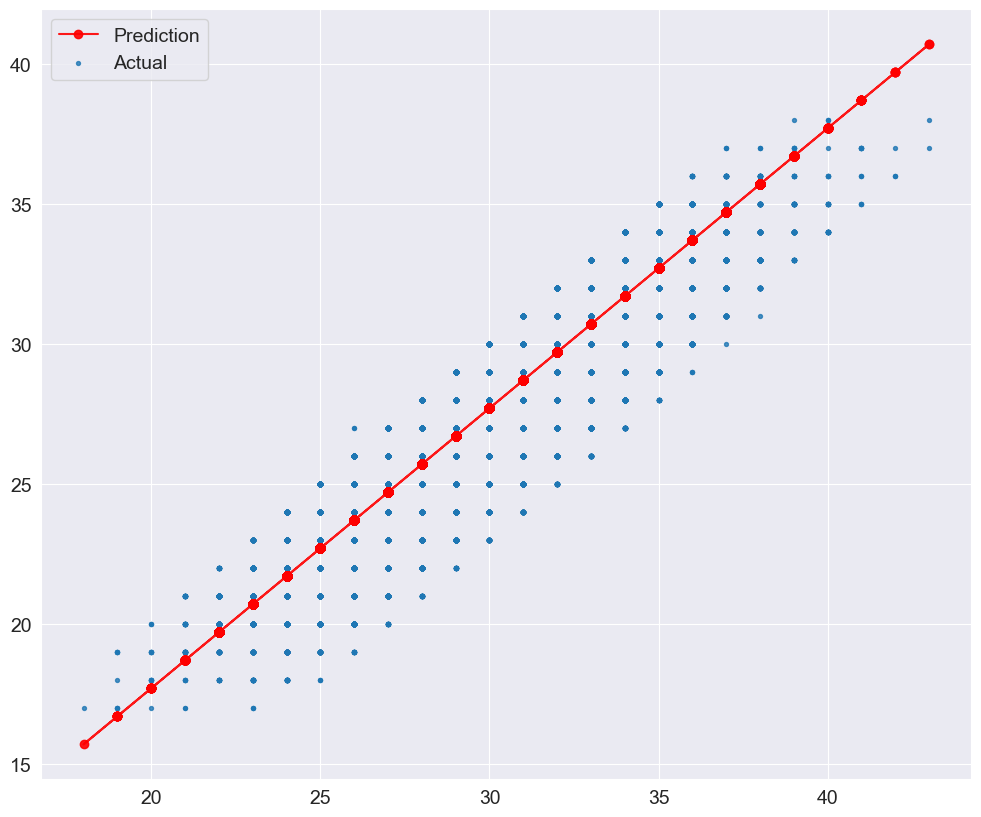

In [33]:
try_parameters(1,-2.3)

In [34]:
from sklearn.linear_model import LinearRegression

In [35]:
lr_model = LinearRegression()

## Final Linear Regression Model For Tempc

In [36]:
# Create inputs and targets
inputs, targets = train_df[input_cols_temp], train_df['tempC']

# Create and train the model
lr_model = LinearRegression().fit(inputs, targets)

# Generate predictions
predictions = lr_model.predict(inputs)

# Compute loss to evalute the model
loss = rmse(targets, predictions)
print('RMSE Loss:', loss)

RMSE Loss: 0.9025856737296836


In [38]:
# W
lr_model.coef_ 

array([-0.00631458,  0.43744408,  0.21013161, -0.43867233,  0.35269408,
        0.72932478,  0.00175666,  0.02791379,  0.01322592])

In [39]:
# b
lr_model.intercept_

-3.43582758075787

In [40]:
input_cols_temp

['maxtempC',
 'mintempC',
 'uvIndex',
 'HeatIndexC',
 'FeelsLikeC',
 'WindChillC',
 'winddirDegree',
 'windspeedKmph',
 'WindGustKmph']

## Testing LR Model on Test df

In [41]:
# Create inputs and targets
inputs, targets = train_df[input_cols_temp], train_df['tempC']

# Create and train the model
new_inputs = test_df[input_cols_temp]
model = LinearRegression().fit(inputs, targets)

# Generate predictions
predictions = model.predict(new_inputs)
new_targets = test_df['tempC']
# Compute loss to evalute the model
loss = rmse(new_targets, predictions)
print('RMSE Loss:', loss)

RMSE Loss: 1.7608178366205873


In [42]:
from sklearn.linear_model import SGDRegressor

In [43]:
train_df.columns

Index(['date_time', 'maxtempC', 'mintempC', 'uvIndex', 'DewPointC',
       'FeelsLikeC', 'HeatIndexC', 'WindChillC', 'WindGustKmph', 'cloudcover',
       'humidity', 'precipMM', 'pressure', 'tempC', 'visibility',
       'winddirDegree', 'windspeedKmph'],
      dtype='object')

In [44]:
# Create inputs and targets
sgd_inputs, sgd_targets = train_df[['WindChillC' , 'uvIndex' ,'maxtempC','FeelsLikeC','HeatIndexC' , 'mintempC' ]], train_df['tempC']

# Create and train the model
sgd_model = SGDRegressor(random_state=38).fit(sgd_inputs, sgd_targets)

# Generate predictions
sgd_predictions = sgd_model.predict(train_df[['WindChillC' , 'uvIndex' ,'maxtempC','FeelsLikeC','HeatIndexC' , 'mintempC' ]])

# Compute loss to evalute the model
sgd_loss = rmse(sgd_targets, sgd_predictions)
print('RMSE Loss:', sgd_loss)

RMSE Loss: 0.9538325194391319


In [45]:
df

,date_time,maxtempC,mintempC,uvIndex,DewPointC,FeelsLikeC,HeatIndexC,WindChillC,WindGustKmph,cloudcover,humidity,precipMM,pressure,tempC,visibility,winddirDegree,windspeedKmph
0,01-01-2009 00:00,30,22,1,15,28,28,27,11,0,49,0.0,1012,22,10,20,10
1,01-01-2009 01:00,30,22,1,15,27,27,26,12,0,50,0.0,1012,22,10,18,11
2,01-01-2009 02:00,30,22,1,15,27,27,26,14,0,50,0.0,1012,22,10,16,12
3,01-01-2009 03:00,30,22,1,14,25,26,25,15,0,50,0.0,1012,22,10,14,13
4,01-01-2009 04:00,30,22,1,14,26,26,26,14,0,49,0.0,1013,22,10,28,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96427,01-01-2020 19:00,27,24,6,18,26,26,25,16,4,64,0.0,1014,25,10,324,14
96428,01-01-2020 20:00,27,24,1,18,26,26,25,15,4,65,0.0,1015,25,10,330,13
96429,01-01-2020 21:00,27,24,1,18,26,26,25,14,4,67,0.0,1015,25,10,335,13
96430,01-01-2020 22:00,27,24,1,18,26,26,25,13,4,66,0.0,1015,25,10,301,12


In [53]:
df.columns

Index(['date_time', 'maxtempC', 'mintempC', 'uvIndex', 'DewPointC',
       'FeelsLikeC', 'HeatIndexC', 'WindChillC', 'WindGustKmph', 'cloudcover',
       'humidity', 'precipMM', 'pressure', 'tempC', 'visibility',
       'winddirDegree', 'windspeedKmph'],
      dtype='object')

In [55]:
input_cols = ['maxtempC', 'mintempC', 'uvIndex', 'DewPointC',
       'FeelsLikeC', 'HeatIndexC', 'WindChillC', 'WindGustKmph', 'cloudcover',
       'humidity', 'precipMM', 'pressure', 'visibility',
       'winddirDegree', 'windspeedKmph']
target_col = 'tempC'
numeric_cols = input_cols.copy()

In [56]:
X_train, train_targets = train_df[input_cols], train_df[target_col]
X_val , val_targets = test_df[input_cols], test_df[target_col]

In [57]:
X_train

,maxtempC,mintempC,uvIndex,DewPointC,FeelsLikeC,HeatIndexC,WindChillC,WindGustKmph,cloudcover,humidity,precipMM,pressure,visibility,winddirDegree,windspeedKmph
0,30,22,1,15,28,28,27,11,0,49,0.0,1012,10,20,10
1,30,22,1,15,27,27,26,12,0,50,0.0,1012,10,18,11
2,30,22,1,15,27,27,26,14,0,50,0.0,1012,10,16,12
3,30,22,1,14,25,26,25,15,0,50,0.0,1012,10,14,13
4,30,22,1,14,26,26,26,14,0,49,0.0,1013,10,28,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
87643,29,22,6,14,27,27,27,13,3,46,0.0,1018,10,234,11
87644,29,22,1,13,26,26,26,11,4,44,0.0,1018,10,132,8
87645,29,22,1,11,25,25,25,9,6,42,0.0,1018,10,31,6
87646,29,22,1,12,26,26,26,10,4,42,0.0,1018,10,29,8


In [61]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
scaler.fit(X_train[numeric_cols])


X_train[numeric_cols] = scaler.transform(X_train[numeric_cols])
X_val[numeric_cols] = scaler.transform(X_val[numeric_cols])

C:\Users\Saket\AppData\Local\Temp\ipykernel_22064\3403294613.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\Saket\AppData\Local\Temp\ipykernel_22064\3403294613.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [62]:
X_train

,maxtempC,mintempC,uvIndex,DewPointC,FeelsLikeC,HeatIndexC,WindChillC,WindGustKmph,cloudcover,humidity,precipMM,pressure,visibility,winddirDegree,windspeedKmph
0,0.428571,0.384615,0.000,0.466667,0.250,0.250,0.36,0.134146,0.00,0.381579,0.0,0.666667,1.0,0.055556,0.250
1,0.428571,0.384615,0.000,0.466667,0.225,0.225,0.32,0.146341,0.00,0.394737,0.0,0.666667,1.0,0.050000,0.275
2,0.428571,0.384615,0.000,0.466667,0.225,0.225,0.32,0.170732,0.00,0.394737,0.0,0.666667,1.0,0.044444,0.300
3,0.428571,0.384615,0.000,0.433333,0.175,0.200,0.28,0.182927,0.00,0.394737,0.0,0.666667,1.0,0.038889,0.325
4,0.428571,0.384615,0.000,0.433333,0.200,0.200,0.32,0.170732,0.00,0.381579,0.0,0.708333,1.0,0.077778,0.300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
87643,0.357143,0.384615,0.625,0.433333,0.225,0.225,0.36,0.158537,0.03,0.342105,0.0,0.916667,1.0,0.650000,0.275
87644,0.357143,0.384615,0.000,0.400000,0.200,0.200,0.32,0.134146,0.04,0.315789,0.0,0.916667,1.0,0.366667,0.200
87645,0.357143,0.384615,0.000,0.333333,0.175,0.175,0.28,0.109756,0.06,0.289474,0.0,0.916667,1.0,0.086111,0.150
87646,0.357143,0.384615,0.000,0.366667,0.200,0.200,0.32,0.121951,0.04,0.289474,0.0,0.916667,1.0,0.080556,0.200


In [63]:
X_val

,maxtempC,mintempC,uvIndex,DewPointC,FeelsLikeC,HeatIndexC,WindChillC,WindGustKmph,cloudcover,humidity,precipMM,pressure,visibility,winddirDegree,windspeedKmph
87648,0.571429,0.538462,0.000,0.433333,0.250,0.250,0.40,0.146341,0.01,0.289474,0.0,0.916667,1.0,0.069444,0.275
87649,0.571429,0.538462,0.000,0.400000,0.250,0.250,0.40,0.146341,0.01,0.263158,0.0,0.916667,1.0,0.091667,0.250
87650,0.571429,0.538462,0.000,0.366667,0.225,0.225,0.36,0.134146,0.01,0.236842,0.0,0.875000,1.0,0.111111,0.250
87651,0.571429,0.538462,0.000,0.333333,0.225,0.225,0.36,0.134146,0.01,0.210526,0.0,0.875000,1.0,0.133333,0.225
87652,0.571429,0.538462,0.000,0.266667,0.200,0.200,0.32,0.134146,0.02,0.184211,0.0,0.875000,1.0,0.150000,0.225
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96427,0.214286,0.538462,0.625,0.566667,0.200,0.200,0.28,0.195122,0.04,0.578947,0.0,0.750000,1.0,0.900000,0.350
96428,0.214286,0.538462,0.000,0.566667,0.200,0.200,0.28,0.182927,0.04,0.592105,0.0,0.791667,1.0,0.916667,0.325
96429,0.214286,0.538462,0.000,0.566667,0.200,0.200,0.28,0.170732,0.04,0.618421,0.0,0.791667,1.0,0.930556,0.325
96430,0.214286,0.538462,0.000,0.566667,0.200,0.200,0.28,0.158537,0.04,0.605263,0.0,0.791667,1.0,0.836111,0.300


In [64]:
def rmse(targets , predictions):
    return np.sqrt(np.mean(np.square(targets-predictions)))

def mse(targets , predictions):
    return np.mean(np.square(targets-predictions))

In [67]:
from sklearn.metrics import accuracy_score

def evalmodel(model,**params):
    model = model(**params).fit(X_train,train_targets)
    train_preds = model.predict(X_train)
    val_preds = model.predict(X_val)
    return {
        # 'train_score': f'{round(accuracy_score(train_preds,train_targets)*100,2)}%',
        # 'val_score' : f'{round(accuracy_score(val_preds,val_targets)*100,2)}%' ,
        'train_rmse': f'Train RMSE : {rmse(train_targets,train_preds)}',
        'val_rmse': f'Val RMSE : {rmse(val_targets,val_preds)}'
    }

In [76]:
evalmodel(SGDRegressor)

{'train_rmse': 'Train RMSE : 0.8777649529315212',
 'val_rmse': 'Val RMSE : 1.8140259215051104'}